# Finishing preprocessing on the unlabeled data

First we get the unlabeled data using similar code as in the last milestone

In [ ]:
import requests
import tqdm as tqdm
import os
# We can find all the different product collections at kbdfans.com/collections.json
collections = requests.get('https://kbdfans.com/collections.json?limit=250').json()['collections']
print([collection['handle'] for collection in collections])

# Heres the data for their different keycap sets
keycap_sets = requests.get('https://kbdfans.com/collections/keycaps/products.json?limit=250&page=0').json()['products']
print([product['title'] for product in keycap_sets])

if not os.path.exists('UnlabeledData'):
  os.mkdir('UnlabeledData')

# Image downloading code from https://stackoverflow.com/questions/30229231/python-save-image-from-url
for i, keycap_set in tqdm.tqdm(list(enumerate(keycap_sets))):
  image_url = keycap_set['images'][0]['src']
  img_data = requests.get(image_url).content
  with open(f'UnlabeledData/{i}.jpg', 'wb') as handler:
      handler.write(img_data)

['100-assembled-keyboard', '100-diy-kit', '100-keyboard', '20-fully-assembled', '20-diy-kit', '20-keyboard', '20-keyboard-category', '20-layout-case', '20', '2024-cny', '40', '40-fully-assembled', '40-diy-kit', '40-keyboard-category', '40-layout-case', '50', '50-diy-kit', '50-layout-plate', '60', '60-fully-assembled', '60-diy-kit', '60-keyboard', '60-keyboard-category', '60-layout-case', '60-layout-plate-1', '65', '65-fully-assembled', '65-diy-kit', '65-keyboard', '65-keyboard-category', '65-layout-case', '65-layout-plate', '75', '75-fully-assembled', '75-diy-kit', '75-keyboard', '75-keyboard-category', '75-layout-case', '75-layout-plate', '90-kbd19x', '80-fully-assembled', '80-diy-kit', '80-keyboard', '80-keyboard-category', '80-layout-plate', '90-diy-kit-1', '95-kbd19x', '95-fully-assembled', '95-diy-kit', '95-keyboard', '95-keyboard-category', 'keyboard-part', 'akuma', 'artisan-keycap', 'artisan-keycaps', 'artkey', 'assembly-service', 'b-stock', 'b-stock-40', 'b-stock-60', 'b-stock-

100%|██████████| 181/181 [03:18<00:00,  1.10s/it]


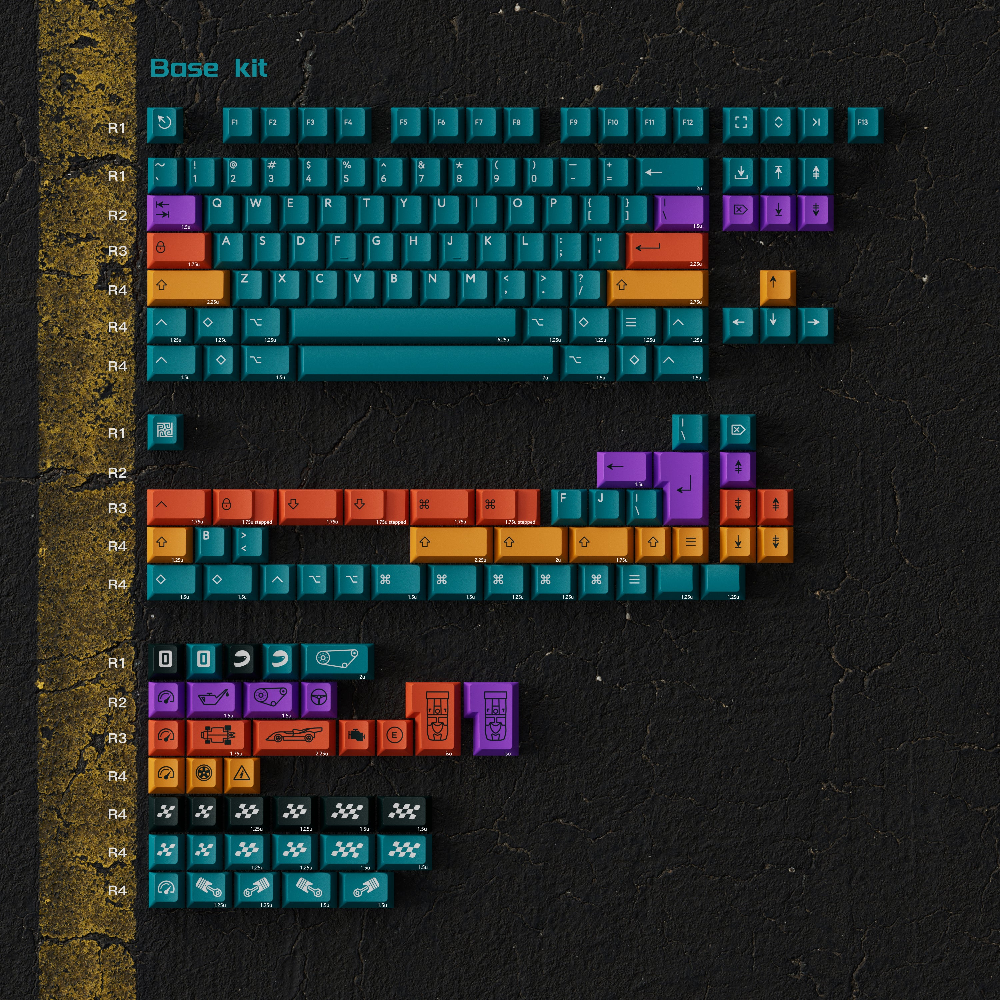

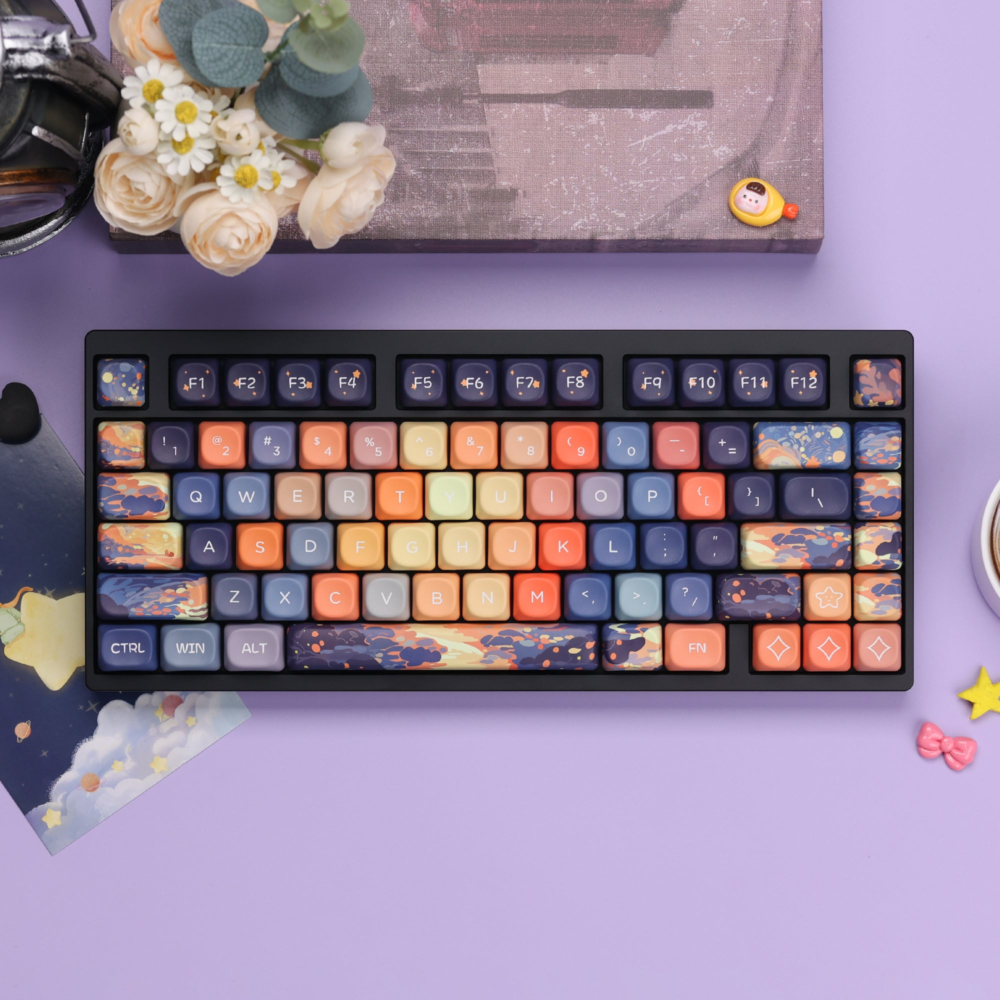

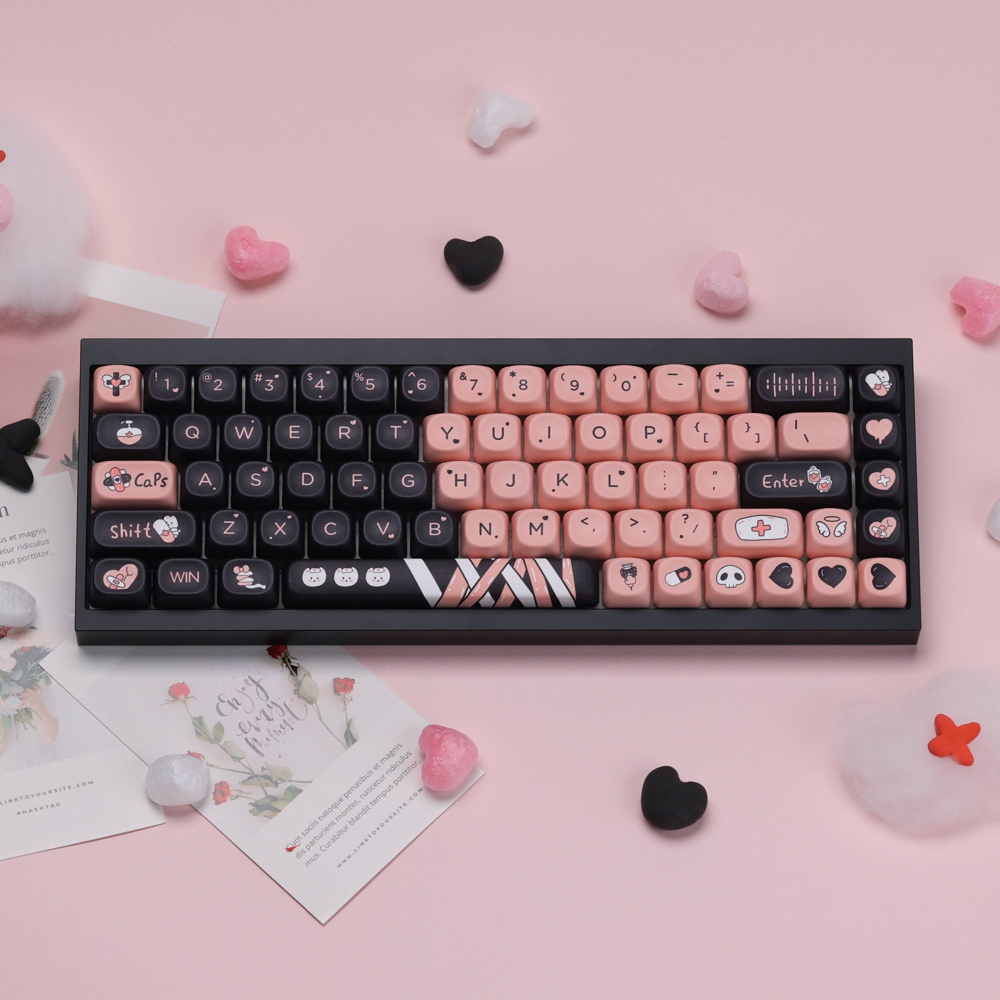

In [ ]:
# Here I create a helper method to visualize images
from IPython.display import Image as JupyterImage
from PIL import Image
from matplotlib import pyplot as plt

def display_image_from_path(filepath: str):
  display(JupyterImage(filepath, width=512, height=512))

def display_image_PIL(image: Image.Image):
  image.save('temp.png')
  display_image_from_path('temp.png')

def display_image_numpy(data):
  plt.imshow(data)

display_image_PIL(Image.open("/content/UnlabeledData/1.jpg"))
display_image_PIL(Image.open("/content/UnlabeledData/2.jpg"))
display_image_PIL(Image.open("/content/UnlabeledData/3.jpg"))

Now its time to actually preprocess the images

In [ ]:
# We load and preprocess our images
import numpy as np
preprocessed_images = []
for image_path in tqdm.tqdm(os.listdir("/content/UnlabeledData")[0:160]):
  img = Image.open('/content/UnlabeledData/'+ image_path)
  # We will skip the few images that aren't square
  if img.width != img.height:
    continue
  img = img.convert('RGB')
  img = img.resize((512,512), resample=Image.Resampling.LANCZOS)

  preprocessed_images.append(np.array(img, dtype=np.uint8))
preprocessed_images = np.stack(preprocessed_images)

100%|██████████| 160/160 [00:34<00:00,  4.63it/s]


In [ ]:
# Now we do image augmentation on the unlabeled images
!pip install imgaug
import imgaug as ia
import imgaug.augmenters as iaa

print(preprocessed_images.shape)

seq = iaa.Sequential([
    iaa.LinearContrast((0.9, 1.1)),
    iaa.Multiply((0.95, 1.05)),
    iaa.Affine(
        scale={"x": (0.9, 1.1), "y": (0.9, 1.1)},
        translate_percent={"x": (-0.05, 0.05), "y": (-0.05, 0.05)},
        rotate=(-8, 8),
        shear=(-6, 6)
    ),

])
result = None
for i in range(2):
  images_aug = seq(images=preprocessed_images)
  if result is None:
    result = images_aug
  else:
    result = np.concatenate((result, images_aug))

(159, 512, 512, 3)


In [ ]:
# Now we just need to save the augmented images
if not os.path.exists('ProcessedUnlabeledData'):
  os.mkdir('ProcessedUnlabeledData')
for i in tqdm.tqdm(range(result.shape[0])):
  image = Image.fromarray(result[i])
  image.save('ProcessedUnlabeledData/' + str(i) + '.png')

100%|██████████| 318/318 [00:54<00:00,  5.85it/s]


In [ ]:
# Zip up the processed unlabeled data so I can download it from the notebook instance
!zip -r processedunlabeleddata.zip /content/ProcessedUnlabeledData
!ls -lh processedunlabeleddata.zip

  adding: content/ProcessedUnlabeledData/ (stored 0%)
  adding: content/ProcessedUnlabeledData/184.png (deflated 2%)
  adding: content/ProcessedUnlabeledData/190.png (deflated 1%)
  adding: content/ProcessedUnlabeledData/5.png (deflated 0%)
  adding: content/ProcessedUnlabeledData/260.png (deflated 0%)
  adding: content/ProcessedUnlabeledData/121.png (deflated 0%)
  adding: content/ProcessedUnlabeledData/21.png (deflated 0%)
  adding: content/ProcessedUnlabeledData/98.png (deflated 0%)
  adding: content/ProcessedUnlabeledData/274.png (deflated 0%)
  adding: content/ProcessedUnlabeledData/126.png (deflated 0%)
  adding: content/ProcessedUnlabeledData/275.png (deflated 0%)
  adding: content/ProcessedUnlabeledData/291.png (deflated 1%)
  adding: content/ProcessedUnlabeledData/192.png (deflated 0%)
  adding: content/ProcessedUnlabeledData/52.png (deflated 0%)
  adding: content/ProcessedUnlabeledData/311.png (deflated 1%)
  adding: content/ProcessedUnlabeledData/45.png (deflated 0%)
  addin

# Training the first model using the labeled data

In [1]:
!pip install transformers evaluate albumentations timm accelerate datasets torchmetrics

# Get annotated data for model training
!wget -q https://github.com/portoaj/CSE151A-Project/raw/main/AnnotatedData.zip
!unzip -n -qq AnnotatedData.zip -d AnnotatedData

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.1/84.1 kB 3.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 15.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 280.0/280.0 kB 20.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 536.7/536.7 kB 23.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 840.4/840.4 kB 27.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 16.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 15.4 MB/s eta 0:00:00


In [2]:
# Lets load the annotations file
import json

with open('/content/AnnotatedData/_annotations.coco.json') as annotations_file:
  annotations_object = json.load(annotations_file)

# The different categories of information stored in the annotations file
print(annotations_object.keys())

dict_keys(['info', 'licenses', 'categories', 'images', 'annotations'])


In [3]:
annotations = annotations_object['annotations']
images = annotations_object['images']

num_annotations = len(annotations)
num_images = len(images)
print(f'There are {num_annotations} annotations and {num_images} images')

There are 1713 annotations and 36 images


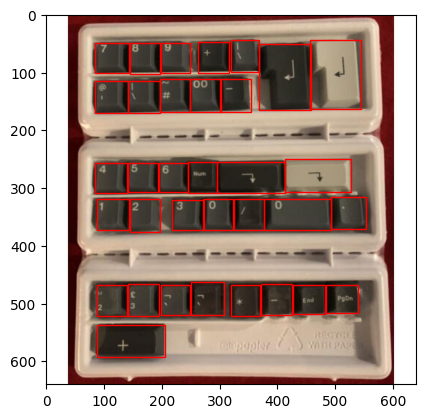

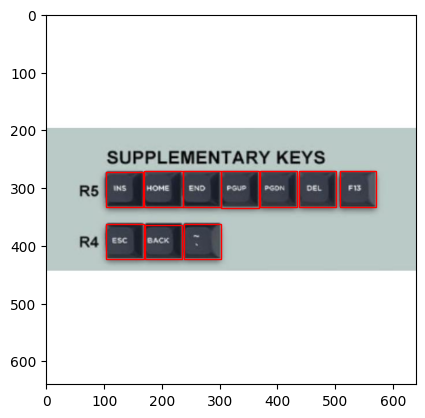

In [4]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

import os

def show_annotated_image(image_id, edgecolor='r'):
  im = Image.open(f'AnnotatedData/{images[image_id]["file_name"]}' )
  # Create figure and axes
  fig, ax = plt.subplots()

  # Display the image
  ax.imshow(im)

  for annotation in annotations:
    if annotation['image_id'] == image_id:
      # Create a Rectangle patch
      width, height = im.size
      data = annotation['bbox']
      x = float(data[0])
      y = float(data[1])
      width = float(data[2])
      height = float(data[3])
      #print(x,y,width,height)
      rect = patches.Rectangle((x,y),width,height, linewidth=1, edgecolor=edgecolor, facecolor='none')
      ax.add_patch(rect)

  # Add the patch to the Axes
  plt.show()

# Here we display the first 2 images with their annotations
for i in range(2):
  show_annotated_image(i)

In [5]:
# Training code adapted from https://huggingface.co/docs/transformers/en/tasks/object_detection
from transformers import AutoImageProcessor, AutoModelForObjectDetection, TrainingArguments, Trainer

checkpoint = "facebook/detr-resnet-50"
image_processor = AutoImageProcessor.from_pretrained(checkpoint)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/274 [00:00<?, ?B/s]

Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration. Please open a PR/issue to update `preprocessor_config.json` to use `image_processor_type` instead of `feature_extractor_type`. This warning will be removed in v4.40.
The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.


In [6]:
import numpy as np
import torch
print(annotations)
print(images)

id2label = {0:'background', 1: 'keycap'}
label2id = {'keycap': 1, 'background': 0}

[{'id': 0, 'image_id': 0, 'category_id': 1, 'bbox': [85, 49, 58, 52], 'area': 3016, 'segmentation': [], 'iscrowd': 0}, {'id': 1, 'image_id': 0, 'category_id': 1, 'bbox': [144, 49, 53, 53], 'area': 2809, 'segmentation': [], 'iscrowd': 0}, {'id': 2, 'image_id': 0, 'category_id': 1, 'bbox': [198, 48, 51, 53], 'area': 2703, 'segmentation': [], 'iscrowd': 0}, {'id': 3, 'image_id': 0, 'category_id': 1, 'bbox': [262, 47, 55, 53], 'area': 2915, 'segmentation': [], 'iscrowd': 0}, {'id': 4, 'image_id': 0, 'category_id': 1, 'bbox': [320, 44, 49, 54], 'area': 2646, 'segmentation': [], 'iscrowd': 0}, {'id': 5, 'image_id': 0, 'category_id': 1, 'bbox': [85, 115, 57, 54], 'area': 3078, 'segmentation': [], 'iscrowd': 0}, {'id': 6, 'image_id': 0, 'category_id': 1, 'bbox': [142, 114, 55, 55], 'area': 3025, 'segmentation': [], 'iscrowd': 0}, {'id': 7, 'image_id': 0, 'category_id': 1, 'bbox': [196, 111, 52, 57], 'area': 2964, 'segmentation': [], 'iscrowd': 0}, {'id': 8, 'image_id': 0, 'category_id': 1, 'bb

In [7]:
def generate_dataset(image_ids):
  dataset = []
  for image_id in image_ids:
    image_obj = list(filter(lambda image: (image['id'] == image_id), images))[0]
    #print(image_obj)
    relevant_annotations = list(filter(lambda annotation: (annotation['image_id'] == image_id), annotations))

    objects = {'id': [annotation['id'] for annotation in relevant_annotations], 'area': [annotation['area'] for annotation in relevant_annotations], 'bbox':[annotation['bbox'] for annotation in relevant_annotations], 'category':[annotation['category_id'] for annotation in relevant_annotations]}

    dataset.append({'image_id': image_id, 'image': Image.open('AnnotatedData/' + image_obj['file_name']), 'width': image_obj['width'], 'height': image_obj['height'], 'objects': objects})
  return dataset

raw_train_dataset = generate_dataset(range(int(len(images) *.7)))
raw_validation_dataset = generate_dataset(range(int(len(images) *.7), int(len(images) *.8)))
raw_test_dataset = generate_dataset(range(int(len(images) *.8), len(images)))

print(len(raw_train_dataset), len(raw_validation_dataset), len(raw_test_dataset))

assert len(raw_train_dataset) + len(raw_validation_dataset) + len(raw_test_dataset) == len(images)

25 3 8


In [8]:
print(raw_train_dataset)

[{'image_id': 0, 'image': <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x640 at 0x7A0EAB8E5030>, 'width': 640, 'height': 640, 'objects': {'id': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], 'area': [3016, 2809, 2703, 2915, 2646, 3078, 3025, 2964, 3135, 3021, 10266, 10235, 6328, 6435, 2703, 2601, 2754, 2912, 2968, 2968, 2805, 2808, 3360, 6380, 2860, 2756, 2968, 2499, 3136, 2805, 2862, 2744, 2688, 6608], 'bbox': [[85, 49, 58, 52], [144, 49, 53, 53], [198, 48, 51, 53], [262, 47, 55, 53], [320, 44, 49, 54], [85, 115, 57, 54], [142, 114, 55, 55], [196, 111, 52, 57], [248, 111, 55, 57], [301, 111, 53, 57], [457, 44, 87, 118], [369, 50, 89, 115], [414, 250, 113, 56], [296, 254, 117, 55], [245, 255, 51, 53], [195, 256, 51, 51], [140, 256, 54, 51], [85, 257, 56, 52], [87, 319, 56, 53], [144, 319, 53, 56], [218, 321, 55, 51], [272, 318, 52, 54], [493, 315, 60, 56], [376, 318, 116, 55], [325, 318, 52, 55

In [9]:
# Configure model and training arguments

model = AutoModelForObjectDetection.from_pretrained(
    checkpoint,
    id2label=id2label,
    label2id=label2id,
    ignore_mismatched_sizes=True,
)

config.json:   0%|          | 0.00/4.59k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/167M [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/torch/_utils.py:831: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()


model.safetensors:   0%|          | 0.00/102M [00:00<?, ?B/s]

Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of DetrForObjectDetection were not initialized from the model checkpoin

In [10]:
import albumentations, datasets
from datasets import Dataset
#from datasets import from_list


def train_formatted_anns(image_id, category, area, bbox):
  annotations = []
  for i in range(0, len(category)):
      new_ann = {
          "image_id": image_id,
          "category_id": category[i],
          "isCrowd": 0,
          "area": area[i],
          "bbox": list(bbox[i]),
      }
      annotations.append(new_ann)

  return annotations

# format annotations the same as for training, no need for data augmentation
def validation_formatted_anns(image_id, objects):
    annotations = []
    for i in range(0, len(objects["id"])):
        new_ann = {
            "id": objects["id"][i],
            "category_id": objects["category"][i],
            "iscrowd": 0,
            "image_id": image_id,
            "area": objects["area"][i],
            "bbox": objects["bbox"][i],
        }
        annotations.append(new_ann)

    return annotations

transform = albumentations.Compose(
    [
        albumentations.HorizontalFlip(p=0.1),
        albumentations.ColorJitter(brightness=0.15, contrast=0.15, saturation=0.15, hue=0.15, p=.5),
        albumentations.Downscale(scale_min=.15, scale_max=.15)

    ],
    bbox_params=albumentations.BboxParams(format="coco", label_fields=["category"]),
)

def train_transform_ann(examples):
  image_ids = examples["image_id"]
  images, bboxes, area, categories = [], [], [], []
  for image, objects in zip(examples["image"], examples["objects"]):
      image = np.array(image.convert("RGB"))[:, :, ::-1]
      out = transform(image=image, bboxes=objects["bbox"], category=objects["category"])

      area.append(objects["area"])
      images.append(out["image"])
      bboxes.append(out["bboxes"])
      categories.append(out["category"])

  targets = [
      {"image_id": id_, "annotations": train_formatted_anns(id_, cat_, ar_, box_)}
      for id_, cat_, ar_, box_ in zip(image_ids, categories, area, bboxes)
  ]

  return image_processor(images=images, annotations=targets, return_tensors="pt")

def validation_transform_ann(examples):
  image_ids = examples["image_id"]
  images, bboxes, area, categories = [], [], [], []
  for image, objects in zip(examples["image"], examples["objects"]):
      image = np.array(image.convert("RGB"))[:, :, ::-1]
      out = transform(image=image, bboxes=objects["bbox"], category=objects["category"])
      area.append(objects["area"])
      #print(image)
      images.append(image)
      #print(objects)
      bboxes.append(objects["bbox"])
      categories.append(objects["category"])

  targets = [
      {"image_id": id_, "annotations": train_formatted_anns(id_, cat_, ar_, box_)}
      for id_, cat_, ar_, box_ in zip(image_ids, categories, area, bboxes)
  ]

  return image_processor(images=images, annotations=targets, return_tensors="pt")


train_dataset = Dataset.from_list(raw_train_dataset).with_transform(train_transform_ann)
validation_dataset = Dataset.from_list(raw_validation_dataset).with_transform(validation_transform_ann)
#test_dataset = Dataset.from_list(raw_test_dataset).with_transform(validation_transform_ann)

def collate_fn(batch):
    pixel_values = [item["pixel_values"] for item in batch]
    encoding = image_processor.pad(pixel_values, return_tensors="pt")
    labels = [item["labels"] for item in batch]
    batch = {}
    batch["pixel_values"] = encoding["pixel_values"]
    batch["pixel_mask"] = encoding["pixel_mask"]
    batch["labels"] = labels
    return batch

/usr/local/lib/python3.10/dist-packages/albumentations/augmentations/transforms.py:1692: UserWarning: Using default interpolation INTER_NEAREST, which is sub-optimal.Please specify interpolation mode for downscale and upscale explicitly.For additional information see this PR https://github.com/albumentations-team/albumentations/pull/584
  warnings.warn(


In [12]:
!rm -rf detr-resnet-50
training_args = TrainingArguments(
    output_dir="detr-resnet-50",
    per_device_train_batch_size=8,
    num_train_epochs=100,
    fp16=False,
    save_steps=100,
    logging_steps=10,
    learning_rate=1e-5,
    weight_decay=1e-4,
    save_total_limit=2,
    remove_unused_columns=False,
    push_to_hub=False,
    evaluation_strategy='steps'
)


# Train model
trainer = Trainer(
    model=model,
    args=training_args,
    data_collator=collate_fn,
    train_dataset=train_dataset,
    eval_dataset=validation_dataset,
    tokenizer=image_processor,
)

trainer.train()

Step,Training Loss,Validation Loss
10,1.348700,1.420298
20,1.372400,1.389148
30,1.320600,1.363587
40,1.273200,1.357148
50,1.220700,1.316111
60,1.230200,1.292884
70,1.220600,1.267447
80,1.151100,1.237305
90,1.163300,1.277099
100,1.141800,1.280227


TrainOutput(global_step=400, training_loss=1.0653056526184081, metrics={'train_runtime': 527.6386, 'train_samples_per_second': 4.738, 'train_steps_per_second': 0.758, 'total_flos': 1.194517296e+18, 'train_loss': 1.0653056526184081, 'epoch': 100.0})

<Axes: >

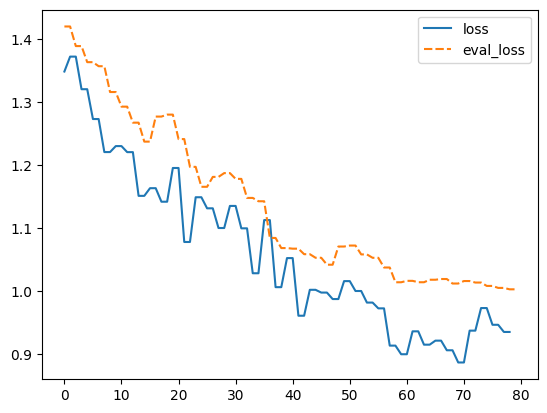

In [13]:
import pandas as pd
import seaborn as sns

training_history = pd.DataFrame(trainer.state.log_history)
training_history = training_history.fillna(method='bfill')
trainer.model
sns.lineplot(data=training_history[['loss', 'eval_loss']])

## Evaluating the Train/ Validation Graph

We can see in the graph that the training loss reaches a lower value than the validation values before both seem to become flat. However, both the training loss and validation loss seemed to have converged to a pretty low loss so it seems like the training/ validation curve is actually pretty balanced. I don't believe the model is overfitting because if the model was overfitting I would expect the validation loss to begin increasing towards the end of the training but it seems to stay relatively level.

In [14]:
import json


# Save images and annotations into the files torchvision.datasets.CocoDetection expects
def save_annotation_file_images(val_dataset):
    output_json = {}
    path_output = f"{os.getcwd()}/val/"

    if not os.path.exists(path_output):
        os.makedirs(path_output)

    path_anno = os.path.join(path_output, "ann.json")
    categories_json = [{"supercategory": "none", "id": id, "name": id2label[id]} for id in id2label]
    output_json["images"] = []
    output_json["annotations"] = []

    for example in val_dataset:
        print(example)
        ann = validation_formatted_anns(example["image_id"], example["objects"])

        output_json["images"].append(
            {
                "id": example["image_id"],
                "width": example["image"].width,
                "height": example["image"].height,
                "file_name": f"{example['image_id']}.png",
            }
        )
        output_json["annotations"].extend(ann)
    output_json["categories"] = categories_json

    with open(path_anno, "w") as file:
        json.dump(output_json, file, ensure_ascii=False, indent=4)

    for im, img_id in zip([data['image'] for data in val_dataset], [data["image_id"] for data in val_dataset]):
        path_img = os.path.join(path_output, f"{img_id}.png")
        im.save(path_img)

    return path_output, path_anno

In [16]:
import torchvision


class CocoDetection(torchvision.datasets.CocoDetection):
    def __init__(self, img_folder, image_processor, ann_file):
        super().__init__(img_folder, ann_file)
        self.image_processor = image_processor

    def __getitem__(self, idx):
        # read in PIL image and target in COCO format
        img, target = super(CocoDetection, self).__getitem__(idx)

        # preprocess image and target: converting target to DETR format,
        # resizing + normalization of both image and target)
        image_id = self.ids[idx]
        target = {"image_id": image_id, "annotations": target}
        encoding = self.image_processor(images=img, annotations=target, return_tensors="pt")
        pixel_values = encoding["pixel_values"].squeeze()  # remove batch dimension
        target = encoding["labels"][0]  # remove batch dimension

        return {"pixel_values": pixel_values, "labels": target}


im_processor = AutoImageProcessor.from_pretrained("/content/detr-resnet-50/checkpoint-400")
path_output, path_anno = save_annotation_file_images(raw_test_dataset)
test_ds_coco_format = CocoDetection(path_output, im_processor, path_anno)

print(test_ds_coco_format)

{'image_id': 28, 'image': <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=640x640 at 0x7A0EAB8E4040>, 'width': 640, 'height': 640, 'objects': {'id': [1211, 1212, 1213, 1214, 1215, 1216, 1217, 1218, 1219, 1220, 1221, 1222, 1223, 1224, 1225, 1226, 1227, 1228, 1229, 1230, 1231, 1232], 'area': [3024, 3240, 3294, 3416, 3360, 3186, 3180, 3240, 3186, 2915, 2915, 2915, 5772, 2916, 2862, 2916, 3024, 2970, 3025, 6102, 6272, 3024], 'bbox': [[160, 464, 54, 56], [239, 141, 54, 60], [296, 142, 54, 61], [352, 142, 56, 61], [409, 142, 56, 60], [239, 200, 54, 59], [298, 199, 53, 60], [353, 199, 54, 60], [410, 199, 54, 59], [241, 260, 53, 55], [297, 260, 53, 55], [354, 260, 53, 55], [411, 260, 52, 111], [239, 318, 54, 54], [297, 318, 53, 54], [354, 317, 54, 54], [240, 374, 54, 56], [297, 375, 54, 55], [354, 375, 55, 55], [412, 374, 54, 113], [239, 432, 112, 56], [355, 432, 54, 56]], 'category': [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]}}
{'image_id': 29, 'image': <PIL.Jpe

In [17]:
import evaluate
from tqdm import tqdm

model = AutoModelForObjectDetection.from_pretrained("/content/detr-resnet-50/checkpoint-400")
module = evaluate.load("ybelkada/cocoevaluate", coco=test_ds_coco_format.coco)
val_dataloader = torch.utils.data.DataLoader(
    test_ds_coco_format, batch_size=1, shuffle=False, num_workers=2, collate_fn=collate_fn
)

with torch.no_grad():
    for idx, batch in enumerate(tqdm(val_dataloader)):
        #print(batch)
        pixel_values = batch["pixel_values"]
        pixel_mask = batch["pixel_mask"]

        labels = [
            {k: v for k, v in t.items()} for t in batch["labels"]
        ]  # these are in DETR format, resized + normalized
        #print('labels:', labels[0]['class_labels'].shape, '\n')
        # forward pass
        outputs = model(pixel_values=pixel_values, pixel_mask=pixel_mask)
        #print('shape', outputs['pred_boxes'].shape, '\n')

        orig_target_sizes = torch.stack([target["orig_size"] for target in labels], dim=0)
        results = im_processor.post_process(outputs, orig_target_sizes)  # convert outputs of model to Pascal VOC format (xmin, ymin, xmax, ymax)

        module.add(prediction=results, reference=labels)
        del batch

results = module.compute()
print(results)

  0%|          | 0/8 [00:00<?, ?it/s]

{'pixel_values': tensor([[[[2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          ...,
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489]],

         [[2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          ...,
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286]],

         [[2.6400, 2.6400, 2.6400,  ..., 2.6400, 2.6400, 2.6400],
          [2.6400, 2.6400, 2.6400,  ..., 2.6400, 2.6400, 2.6400],
          [2.6400, 2.6400

`post_process` is deprecated and will be removed in v5 of Transformers, please use `post_process_object_detection` instead, with `threshold=0.` for equivalent results.
 12%|█▎        | 1/8 [00:06<00:46,  6.60s/it]

{'pixel_values': tensor([[[[2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          ...,
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489]],

         [[2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          ...,
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286]],

         [[2.6400, 2.6400, 2.6400,  ..., 2.6400, 2.6400, 2.6400],
          [2.6400, 2.6400, 2.6400,  ..., 2.6400, 2.6400, 2.6400],
          [2.6400, 2.6400

 25%|██▌       | 2/8 [00:12<00:38,  6.38s/it]

{'pixel_values': tensor([[[[0.8447, 0.8276, 0.8104,  ..., 0.0912, 0.0912, 0.0912],
          [0.8618, 0.8447, 0.8276,  ..., 0.0912, 0.0912, 0.0912],
          [0.8618, 0.8447, 0.8447,  ..., 0.0912, 0.0912, 0.0912],
          ...,
          [0.0056, 0.0056, 0.0056,  ..., 0.7077, 0.6906, 0.6906],
          [0.0056, 0.0056, 0.0056,  ..., 0.6392, 0.6392, 0.6734],
          [0.0056, 0.0056, 0.0056,  ..., 0.5878, 0.6221, 0.6563]],

         [[0.9930, 0.9755, 0.9580,  ..., 0.2227, 0.2227, 0.2227],
          [1.0105, 0.9930, 0.9755,  ..., 0.2227, 0.2227, 0.2227],
          [1.0105, 0.9930, 0.9930,  ..., 0.2227, 0.2227, 0.2227],
          ...,
          [0.1352, 0.1352, 0.1352,  ..., 0.8529, 0.8354, 0.8354],
          [0.1352, 0.1352, 0.1352,  ..., 0.7829, 0.7829, 0.8179],
          [0.1352, 0.1352, 0.1352,  ..., 0.7304, 0.7654, 0.8004]],

         [[1.2108, 1.1934, 1.1759,  ..., 0.4788, 0.4788, 0.4788],
          [1.2282, 1.2108, 1.1934,  ..., 0.4788, 0.4788, 0.4788],
          [1.2282, 1.2108

 38%|███▊      | 3/8 [00:18<00:29,  5.96s/it]

{'pixel_values': tensor([[[[1.9920, 1.9920, 1.9920,  ..., 1.9920, 1.9920, 1.9920],
          [1.9920, 1.9920, 1.9920,  ..., 1.9920, 1.9920, 1.9920],
          [1.9920, 1.9920, 1.9920,  ..., 1.9920, 1.9920, 1.9920],
          ...,
          [1.9920, 1.9920, 1.9920,  ..., 1.9920, 1.9920, 1.9920],
          [1.9920, 1.9920, 1.9920,  ..., 1.9920, 1.9920, 1.9920],
          [1.9920, 1.9920, 1.9920,  ..., 1.9920, 1.9920, 1.9920]],

         [[2.1660, 2.1660, 2.1660,  ..., 2.1660, 2.1660, 2.1660],
          [2.1660, 2.1660, 2.1660,  ..., 2.1660, 2.1660, 2.1660],
          [2.1660, 2.1660, 2.1660,  ..., 2.1660, 2.1660, 2.1660],
          ...,
          [2.1660, 2.1660, 2.1660,  ..., 2.1660, 2.1660, 2.1660],
          [2.1660, 2.1660, 2.1660,  ..., 2.1660, 2.1660, 2.1660],
          [2.1660, 2.1660, 2.1660,  ..., 2.1660, 2.1660, 2.1660]],

         [[2.3786, 2.3786, 2.3786,  ..., 2.3786, 2.3786, 2.3786],
          [2.3786, 2.3786, 2.3786,  ..., 2.3786, 2.3786, 2.3786],
          [2.3786, 2.3786

 50%|█████     | 4/8 [00:23<00:22,  5.71s/it]

{'pixel_values': tensor([[[[1.7865, 1.7865, 1.7865,  ..., 1.6495, 1.6495, 1.6495],
          [1.7865, 1.7865, 1.7865,  ..., 1.6495, 1.6495, 1.6495],
          [1.7865, 1.7865, 1.7865,  ..., 1.6495, 1.6495, 1.6495],
          ...,
          [1.8208, 1.8208, 1.8208,  ..., 1.8208, 1.8208, 1.8208],
          [1.8208, 1.8208, 1.8208,  ..., 1.8208, 1.8208, 1.8208],
          [1.8208, 1.8208, 1.8208,  ..., 1.8208, 1.8208, 1.8208]],

         [[1.9559, 1.9559, 1.9559,  ..., 1.8158, 1.8158, 1.8158],
          [1.9559, 1.9559, 1.9559,  ..., 1.8158, 1.8158, 1.8158],
          [1.9559, 1.9559, 1.9559,  ..., 1.8158, 1.8158, 1.8158],
          ...,
          [1.9909, 1.9909, 1.9909,  ..., 1.9909, 1.9909, 1.9909],
          [1.9909, 1.9909, 1.9909,  ..., 1.9909, 1.9909, 1.9909],
          [1.9909, 1.9909, 1.9909,  ..., 1.9909, 1.9909, 1.9909]],

         [[2.1694, 2.1694, 2.1694,  ..., 2.0300, 2.0300, 2.0300],
          [2.1694, 2.1694, 2.1694,  ..., 2.0300, 2.0300, 2.0300],
          [2.1694, 2.1694

 62%|██████▎   | 5/8 [00:27<00:15,  5.12s/it]

{'pixel_values': tensor([[[[2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          ...,
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489]],

         [[2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          ...,
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286]],

         [[2.6400, 2.6400, 2.6400,  ..., 2.6400, 2.6400, 2.6400],
          [2.6400, 2.6400, 2.6400,  ..., 2.6400, 2.6400, 2.6400],
          [2.6400, 2.6400

 75%|███████▌  | 6/8 [00:34<00:11,  5.83s/it]

{'pixel_values': tensor([[[[2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          ...,
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489]],

         [[2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          ...,
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286]],

         [[2.6400, 2.6400, 2.6400,  ..., 2.6400, 2.6400, 2.6400],
          [2.6400, 2.6400, 2.6400,  ..., 2.6400, 2.6400, 2.6400],
          [2.6400, 2.6400

 88%|████████▊ | 7/8 [00:39<00:05,  5.42s/it]

{'pixel_values': tensor([[[[2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          ...,
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489],
          [2.2489, 2.2489, 2.2489,  ..., 2.2489, 2.2489, 2.2489]],

         [[2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          ...,
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286],
          [2.4286, 2.4286, 2.4286,  ..., 2.4286, 2.4286, 2.4286]],

         [[2.6400, 2.6400, 2.6400,  ..., 2.6400, 2.6400, 2.6400],
          [2.6400, 2.6400, 2.6400,  ..., 2.6400, 2.6400, 2.6400],
          [2.6400, 2.6400

100%|██████████| 8/8 [00:44<00:00,  5.53s/it]


Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.309
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.520
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.353
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.245
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.517
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.900
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.010
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.080
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.447
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.347
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.673
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= la

In [21]:
image_processor = AutoImageProcessor.from_pretrained("/content/detr-resnet-50/checkpoint-400")
model = AutoModelForObjectDetection.from_pretrained("/content/detr-resnet-50/checkpoint-400")
image = Image.open('/content/val/28.png')
with torch.no_grad():
    inputs = image_processor(images=image, return_tensors="pt")
    outputs = model(**inputs)
    #print(outputs.keys())
    target_sizes = torch.tensor([image.size[::-1]])
    results = image_processor.post_process_object_detection(outputs, threshold=0.5, target_sizes=target_sizes )[0]

for score, label, box in zip(results["scores"], results["labels"], results["boxes"]):
    box = [round(i, 2) for i in box.tolist()]
    print(
        f"Detected {model.config.id2label[label.item()]} with confidence "
        f"{round(score.item(), 3)} at location {box}"
    )
print(results)

Detected keycap with confidence 0.538 at location [116.36, 416.65, 205.0, 501.0]
Detected keycap with confidence 0.884 at location [295.16, 196.89, 348.59, 256.07]
Detected keycap with confidence 0.524 at location [145.25, 466.28, 245.62, 544.87]
Detected keycap with confidence 0.71 at location [354.14, 139.48, 410.47, 198.62]
Detected keycap with confidence 0.683 at location [296.38, 194.18, 349.46, 259.11]
Detected keycap with confidence 0.718 at location [298.85, 375.81, 345.47, 430.81]
Detected keycap with confidence 0.858 at location [296.16, 317.53, 347.02, 370.01]
Detected keycap with confidence 0.582 at location [239.54, 319.45, 290.26, 374.8]
Detected keycap with confidence 0.854 at location [235.51, 137.84, 295.58, 197.41]
Detected keycap with confidence 0.628 at location [227.58, 129.21, 299.82, 224.25]
Detected keycap with confidence 0.598 at location [216.32, 546.45, 281.99, 592.22]
Detected keycap with confidence 0.657 at location [81.03, 149.09, 192.76, 222.12]
Detected 

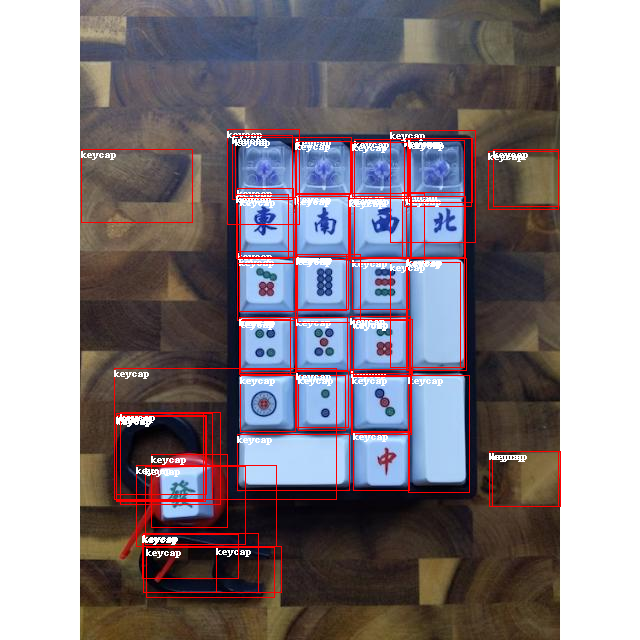

In [22]:
from PIL import ImageDraw
draw = ImageDraw.Draw(image)

for score, label, box in zip(results["scores"], results["labels"], results["boxes"]):
    box = [round(i, 2) for i in box.tolist()]
    x, y, x2, y2 = tuple(box)
    draw.rectangle((x, y, x2, y2), outline="red", width=1)
    draw.text((x, y), model.config.id2label[label.item()], fill="white")
image